# **installments**

In [ ]:

!pip install turicreate


     |████████████████████████████████| 92.0 MB 5.3 kB/s 
     |████████████████████████████████| 86.4 MB 24 kB/s 
     |████████████████████████████████| 322 kB 50.5 MB/s 
     |████████████████████████████████| 3.6 MB 23.2 MB/s 
     |████████████████████████████████| 3.5 MB 27.3 MB/s 
     |████████████████████████████████| 18.3 MB 72 kB/s 
     |████████████████████████████████| 449 kB 62.9 MB/s 
     |████████████████████████████████| 3.8 MB 34.2 MB/s 
     |████████████████████████████████| 2.9 MB 42.7 MB/s 
     |████████████████████████████████| 20.1 MB 59.3 MB/s 
     |████████████████████████████████| 50 kB 4.9 MB/s 
  Created wheel for prettytable: filename=prettytable-0.7.2-py3-none-any.whl size=13714 sha256=a06038c2f47e4751497966bb07de05052157ea1eb9767f3779514c5b45221e87
  Stored in directory: /root/.cache/pip/wheels/b2/7f/f6/f180315b584f00445045ff1699b550fa895d09471337ce21c6
  Created wheel for resampy: filename=resampy-0.2.1-py3-none-any.whl size=320860 sha256=754aa0a009

# **kaggle**

In [ ]:
# see more details in the course first lecture
!mkdir /root/.kaggle/
import json
import os

# Installing the Kaggle package
!pip install kaggle 

#Important Note: complete this with your own key - after running this for the first time remmember to **remove** your API_KEY
api_token = {"username":"grinshpanyonatan","key":"??"}

# creating kaggle.json file with the personal API-Key details 
# You can also put this file on your Google Drive
with open('/root/.kaggle/kaggle.json', 'w') as file:
  json.dump(api_token, file)
!chmod 600 /root/.kaggle/kaggle.json

# 1. first dataset, US_Accidents_Dec20_Updated

In [ ]:
!mkdir ./datasets
!mkdir ./datasets/us-accidents

# download the dataset from Kaggle and unzip it
!kaggle datasets download -d sobhanmoosavi/us-accidents -p ./datasets/us-accidents


!unzip ./datasets/us-accidents/*.zip  -d ./datasets/us-accidents

 96% 279M/290M [00:01<00:00, 145MB/s]
100% 290M/290M [00:01<00:00, 158MB/s]
Archive:  ./datasets/us-accidents/us-accidents.zip
  inflating: ./datasets/us-accidents/US_Accidents_Dec20_Updated.csv  


In [ ]:
import turicreate as tc
import turicreate.aggregate as agg

sf_crashes = tc.SFrame.read_csv('/content/datasets/us-accidents/US_Accidents_Dec20_Updated.csv')
sf_crashes

Finished parsing file /content/datasets/us-accidents/US_Accidents_Dec20_Updated.csv

Parsing completed. Parsed 100 lines in 3.804 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[str,int,str,str,float,float,float,float,float,str,float,str,str,str,str,str,str,str,str,str,str,float,float,float,float,float,str,float,float,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str,str]
If parsing fails due to incorrect types, you can correct
the inferred type list above and pass it to read_csv in
the column_type_hints argument
------------------------------------------------------


Read 133505 lines. Lines per second: 44565.5

Read 533275 lines. Lines per second: 59756.7

Read 933121 lines. Lines per second: 54289.8

Read 1199188 lines. Lines per second: 52849.3

Read 1465023 lines. Lines per second: 51676.9

Read 1730852 lines. Lines per second: 49743.1

Read 1996694 lines. Lines per second: 48966.2

Read 2262498 lines. Lines per second: 48280.2

Read 2528384 lines. Lines per second: 47718.5

Read 2794243 lines. Lines per second: 47219.7

Finished parsing file /content/datasets/us-accidents/US_Accidents_Dec20_Updated.csv

Parsing completed. Parsed 2906610 lines in 59.9775 secs.

ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng
A-1,2,2019-05-21 08:29:55,2019-05-21 09:29:40,34.808868,-82.26915699999999
A-2,2,2019-10-07 17:43:09,2019-10-07 19:42:50,35.09008,-80.74556
A-3,2,2020-12-13 21:53:00,2020-12-13 22:44:00,37.14573,-121.985052
A-4,2,2018-04-17 16:51:23,2018-04-17 17:50:46,39.11039,-119.773781
A-5,3,2016-08-31 17:40:49,2016-08-31 18:10:49,26.102942,-80.265091
A-6,3,2018-10-17 16:40:36,2018-10-17 17:10:18,35.348240000000004,-80.84722099999999
A-7,4,2019-12-12 09:48:52,2019-12-12 10:18:05,39.52397,-107.777
A-8,2,2019-12-21 23:59:00,2019-12-22 00:32:06,34.034017,-118.026972
A-9,2,2018-05-23 16:50:24,2018-05-23 22:50:24,35.863490000000006,-86.83168
A-10,2,2019-01-30 08:44:18,2019-01-30 09:14:17,34.42633,-118.5851


lets add another dataset, the population in each county https://www2.census.gov/programs-surveys/popest/datasets/2010-2020/counties/totals/

In [ ]:
!wget https://www2.census.gov/programs-surveys/popest/datasets/2010-2020/counties/totals/co-est2020-alldata.csv

--2021-08-10 13:47:52--  https://www2.census.gov/programs-surveys/popest/datasets/2010-2020/counties/totals/co-est2020-alldata.csv
Resolving www2.census.gov (www2.census.gov)... 23.79.57.150, 2600:1408:2000:1b2::208c, 2600:1408:2000:1bc::208c
Connecting to www2.census.gov (www2.census.gov)|23.79.57.150|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: unspecified [text/csv]
Saving to: ‘co-est2020-alldata.csv’

co-est2020-alldata.     [ <=>                ]   3.83M  24.9MB/s    in 0.2s    

2021-08-10 13:47:52 (24.9 MB/s) - ‘co-est2020-alldata.csv’ saved [4012355]



In [ ]:
sf_population = tc.SFrame.read_csv('/content/co-est2020-alldata.csv')
sf_population = sf_population['STNAME','CTYNAME','POPESTIMATE2016','POPESTIMATE2017','POPESTIMATE2018','POPESTIMATE2019','POPESTIMATE2020']
#remove a corrupted row
sf_population1 = sf_population[:1835]
sf_population2 =  sf_population[1836:]
sf_population = sf_population1.append(sf_population2)
#remove hawaii and alsaka
sf_population = sf_population[sf_population['STNAME'] != 'Hawaii']
sf_population = sf_population[sf_population['STNAME'] != 'Alaska']
sf_population

Finished parsing file /content/co-est2020-alldata.csv

Parsing completed. Parsed 100 lines in 0.141057 secs.

------------------------------------------------------
Inferred types from first 100 line(s) of file as 
column_type_hints=[int,int,int,int,int,str,str,str,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,int,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float,float]
If parsing fails due to incorrect t

Finished parsing file /content/co-est2020-alldata.csv

Parsing completed. Parsed 3194 lines in 0.134546 secs.

STNAME,CTYNAME,POPESTIMATE2016,POPESTIMATE2017,POPESTIMATE2018,POPESTIMATE2019,POPESTIMATE2020
Alabama,Alabama,4866824,4877989,4891628,4907965,4921532
Alabama,Autauga County,55302,55448,55533,55769,56145
Alabama,Baldwin County,207787,212737,218071,223565,229287
Alabama,Barbour County,25828,25169,24887,24657,24589
Alabama,Bibb County,22590,22532,22300,22313,22136
Alabama,Blount County,57487,57801,57770,57840,57879
Alabama,Bullock County,10397,10181,10165,10144,9976
Alabama,Butler County,20040,19911,19675,19501,19504
Alabama,Calhoun County,115036,114746,114298,114070,113469
Alabama,Chambers County,33742,33716,33570,33244,32865


### 0 data preperation

In [ ]:
#clean the datasets so that the cities have the exact same name
sf_population['CTYNAME'] = sf_population['CTYNAME'].apply(lambda a: a.lower().replace('county','').strip())
sf_crashes['County'] = sf_crashes['County'].apply(lambda a: a.lower())

In [ ]:
#make sure both cities are named the same way
us_state_abbrev = {
    'Alabama': 'AL',
    'Alaska': 'AK',
    'American Samoa': 'AS',
    'Arizona': 'AZ',
    'Arkansas': 'AR',
    'California': 'CA',
    'Colorado': 'CO',
    'Connecticut': 'CT',
    'Delaware': 'DE',
    'District of Columbia': 'DC',
    'Florida': 'FL',
    'Georgia': 'GA',
    'Guam': 'GU',
    'Hawaii': 'HI',
    'Idaho': 'ID',
    'Illinois': 'IL',
    'Indiana': 'IN',
    'Iowa': 'IA',
    'Kansas': 'KS',
    'Kentucky': 'KY',
    'Louisiana': 'LA',
    'Maine': 'ME',
    'Maryland': 'MD',
    'Massachusetts': 'MA',
    'Michigan': 'MI',
    'Minnesota': 'MN',
    'Mississippi': 'MS',
    'Missouri': 'MO',
    'Montana': 'MT',
    'Nebraska': 'NE',
    'Nevada': 'NV',
    'New Hampshire': 'NH',
    'New Jersey': 'NJ',
    'New Mexico': 'NM',
    'New York': 'NY',
    'North Carolina': 'NC',
    'North Dakota': 'ND',
    'Northern Mariana Islands':'MP',
    'Ohio': 'OH',
    'Oklahoma': 'OK',
    'Oregon': 'OR',
    'Pennsylvania': 'PA',
    'Puerto Rico': 'PR',
    'Rhode Island': 'RI',
    'South Carolina': 'SC',
    'South Dakota': 'SD',
    'Tennessee': 'TN',
    'Texas': 'TX',
    'Utah': 'UT',
    'Vermont': 'VT',
    'Virgin Islands': 'VI',
    'Virginia': 'VA',
    'Washington': 'WA',
    'West Virginia': 'WV',
    'Wisconsin': 'WI',
    'Wyoming': 'WY'
}
sf_population['State'] = sf_population['STNAME'].apply(lambda a: us_state_abbrev[a])

In [ ]:
#create a state dictionary for each year 
state_dict_2016 = {}
state_dict_2017 = {}
state_dict_2018 = {}
state_dict_2019 = {}
state_dict_2020 = {}

for r in sf_population['STNAME'].unique():
  state = sf_population[sf_population['STNAME'] == r][0]
  state_dict_2016[state['State']] = state['POPESTIMATE2016']
  state_dict_2017[state['State']] = state['POPESTIMATE2017']
  state_dict_2018[state['State']] = state['POPESTIMATE2018']
  state_dict_2019[state['State']] = state['POPESTIMATE2019']
  state_dict_2020[state['State']] = state['POPESTIMATE2020']

#create a dictionary that holds the population for each year
#we will use this later to show information
all_state_dict = {}
all_state_dict['2016'] = state_dict_2016
all_state_dict['2017'] = state_dict_2017
all_state_dict['2018'] = state_dict_2018
all_state_dict['2019'] = state_dict_2019
all_state_dict['2020'] = state_dict_2020


In [ ]:
#create a population dictinary for each year
pop_16 = 0 
pop_17 = 0 
pop_18 = 0 
pop_19 = 0 
pop_20 = 0 
usa_population_dict = {}

for r in sf_population['STNAME'].unique():
  state = sf_population[sf_population['STNAME'] == r][0]
  pop_16 = pop_16 + state['POPESTIMATE2016'] 
  pop_17 = pop_17 + state['POPESTIMATE2017'] 
  pop_18 = pop_18 + state['POPESTIMATE2018'] 
  pop_19 = pop_19 + state['POPESTIMATE2019'] 
  pop_20 = pop_20 + state['POPESTIMATE2020'] 
  

usa_population_dict['2016'] = pop_16
usa_population_dict['2017'] = pop_17
usa_population_dict['2018'] = pop_18
usa_population_dict['2019'] = pop_19
usa_population_dict['2020'] = pop_20


now we will combine the 2 sframes into one sframe using inner join

In [ ]:
#this will take some time
sf = sf_crashes.join(sf_population,on={'State':'State','County':'CTYNAME'},how='inner')
sf = sf.drop_duplicates(['ID'])
sf.save('master_sf')


In [ ]:
#now we have one sframe that hold all the data we need 
import turicreate as tc
sf = tc.load_sframe('master_sf')
sf

ID,Severity,Start_Time,End_Time,Start_Lat,Start_Lng
A-668123,2,2018-08-09 17:48:44,2018-08-09 18:18:28,34.902958,-82.350174
A-1479474,4,2020-09-26 00:03:30,2020-09-26 03:08:06,37.462445,-77.853208
A-510706,2,2017-07-06 04:13:44,2017-07-06 10:13:44,33.436069,-111.946867
A-1476214,3,2017-10-28 21:14:02,2017-10-28 21:43:13,43.094669,-76.05381
A-290347,3,2017-06-25 15:34:09,2017-06-25 16:03:50,33.102501000000004,-117.311295
A-1429604,3,2017-06-05 01:15:16,2017-06-05 01:59:57,38.169338,-122.199928
A-2885805,2,2018-11-15 14:40:03,2018-11-15 15:09:55,35.162785,-80.817406
A-578978,2,2018-12-06 13:56:38,2018-12-06 14:26:15,34.037690000000005,-117.80511
A-487709,4,2017-06-27 15:17:48,2017-06-27 21:17:48,36.05737,-79.077421
A-142206,2,2018-07-27 13:34:19,2018-07-27 14:04:09,39.135365,-121.544464


In [ ]:
#create dictionary of all states 
sf['County'] = sf.apply(lambda c: c['County'] + ' ' + c['State'] )
county_dict_2016 = {}
county_dict_2017 = {}
county_dict_2018 = {}
county_dict_2019 = {}
county_dict_2020= {}

for r in sf:
  county_dict_2016[r['County']] = r['POPESTIMATE2016']
  county_dict_2017[r['County']] = r['POPESTIMATE2017']
  county_dict_2018[r['County']] = r['POPESTIMATE2018']
  county_dict_2019[r['County']] = r['POPESTIMATE2019']
  county_dict_2020[r['County']] = r['POPESTIMATE2020']

#create a dictionary that holds each counties population
all_counties_dict = {}
all_counties_dict['2016'] = county_dict_2016
all_counties_dict['2017'] = county_dict_2017
all_counties_dict['2018'] = county_dict_2018
all_counties_dict['2019'] = county_dict_2019
all_counties_dict['2020'] = county_dict_2020
county_state_dict = {}
sf_county_state = sf['County','State']
for r in sf_county_state:
  county_state_dict[r['County']] = r['State'] 

Adding to the dataset the columns: year,month,day and hour for additional information

In [ ]:
def get_year(date):
  return date.split('-')[0]
def get_month(date):
  return date.split('-')[1]
def get_day(date):
  return date.split('-')[2].split(' ')[0]
def get_hour(date):
  return date.split('-')[2].split(' ')[1].split(':')[0]

In [ ]:
def get_year(date):
  return date.split('-')[0]
def get_month(date):
  return date.split('-')[1]
def get_day(date):
  return date.split('-')[2].split(' ')[0]
def get_hour(date):
  return date.split('-')[2].split(' ')[1].split(':')[0]

In [ ]:
# we add the column of year , month and day
sf['year'] = sf['End_Time'].apply(lambda date: get_year(date))
sf['month'] = sf['End_Time'].apply(lambda date: get_month(date))
sf['day'] = sf['End_Time'].apply(lambda date: get_day(date))
sf['hour'] = sf['End_Time'].apply(lambda date: get_hour(date))
sf = sf[sf['year'] != '2021']

In [ ]:
# we add the day of the week that the accident occured
from datetime import datetime
import calendar
def date_to_weekday(date_):
  date_ = date_[:16]
  my_date = datetime.strptime(date_, "%Y-%m-%d %H:%M")
  return calendar.day_name[my_date.weekday()] 

sf['day of the week'] = sf['Start_Time'].apply(lambda date_: date_to_weekday(date_))

### 1.1 Basic information about the first dataset

In [ ]:
from matplotlib import pyplot as plt
import plotly.express as px
import turicreate.aggregate as agg
g = sf.groupby('year', {'Number of crashes': agg.COUNT()}).sort('year')
g = g.to_dataframe()
px.bar(g, x='year', y='Number of crashes', color='year',title='number of cashes per year')

we can see a significant increase in each year with 2020 having the biggest increase (this is probably because our dataset has more accidents in 2020 then in other years and not because an increase in accidents)

In [ ]:
#now we will show population growth
plot_dict = {}
plot_dict['year'] = usa_population_dict.keys()
plot_dict['population'] = usa_population_dict.values()
fig = px.bar(plot_dict, x='year', y='population',color='year',title='population growth per year')
fig.show()

we can see no significant increase in population

-------------------------------------------------------

lets define function that will display some interesting graphs

In [ ]:
#@title functions that help draw graph
def display_graph_by_2_coulmns(sframe,group_by1, group_by2):
  g = sf.groupby([group_by1,group_by2] ,{'Number of crashes': agg.COUNT()}).sort(group_by2)
  return g

def add_percent(sframe,group_by1):
  s_dict = sframe.groupby([group_by1])['Number of crashes'].sum()
  sframe['sum'] = sframe[group_by1].apply(lambda s: s_dict[s])
  sframe['percent']  = 100*(sframe['Number of crashes']/sframe['sum'])
  sframe['percent'] = sframe['percent'].apply(lambda p: '{0:.2f}'.format(p)+'%')
  return sframe

def sort_by_accumaltive(sframe,group_by1,group_by2,group_by3='Number of crashes'):
  s_dict = sframe.groupby([group_by1])[group_by3].sum()
  sframe['sum'] = sframe[group_by1].apply(lambda s: s_dict[s])
  sframe = sframe.sort_values([group_by2,'sum'])
  return sframe

def fig_draw(sframe,group_by1,group_by2):
    fig = px.bar(sframe,x=group_by1,y='Number of crashes',color=group_by2,barmode='stack',title='crashes per {} shown by {}'.format(group_by1,group_by2),
              custom_data=['percent',group_by2] )
    return fig

def fig_update(fig,group_by1,group_by2):
    fig.update_traces(hovertemplate=
                  '{}'.format(group_by1)+
                  ": %{x}"+
                  "<br>total crashes: %{y}"+
                  '<br>{}'.format(group_by2)+
                  ":%{customdata[1]}"+
                  '<br>{}'.format(group_by2)+
                  " percent: %{customdata[0]}"            
  )
    
def fig_draw_orientation(sframe,group_by1,group_by2,group_by3='sum',group_by4='percent',group_by5='state population'):
  fig = px.bar(sframe,x=group_by3, y=group_by1, title='number of crashes by {}'.format(group_by4)
  ,barmode='stack',color=group_by2,orientation='h',
              custom_data=[group_by1,group_by2,group_by4,'Number of crashes',group_by5]
      ,width=860, height=900)
  return fig



def fig_update_orientaion(fig,group_by1,group_by2,group_by3,group_by4):
  fig.update_traces(hovertemplate="<br>".join([  
          '{}'.format(group_by2)+ 
          ": %{customdata[1]}",
          '{}'.format(group_by1)+ 
          ": %{customdata[0]}",
          "Number of crashes this year: %{customdata[3]}",
          '{}'.format(group_by4)+  
          ": %{customdata[4]}",
          '{}'.format(group_by3)+                                            
          ": %{customdata[2]}",
         
        
            ]))

In [ ]:
#year = the year of the crash 
#total crashes = total crashes that year 
#severity = severity of the crash 
#severity percent = the percent of the severity from the severities that year 
g = display_graph_by_2_coulmns(sf,'year','Severity')
g = g.to_dataframe()
g = add_percent(g,'year')
fig = fig_draw(g,'year','Severity')
fig_update(fig,'year','Severity')
fig.show()
# hover over the bars for additional information

we can see 2020 has a massive increase in level 2 accidents and that they represented 83.14% of the accidents that year

In [ ]:
# we can choose any 2 features, now we will diplay year and day/night
g = display_graph_by_2_coulmns(sf,'year','Sunrise_Sunset')
g = g.to_dataframe()
g = add_percent(g,'year')
fig = fig_draw(g,'year','Sunrise_Sunset')
fig_update(fig,'year','Sunrise_Sunset')
fig.show()

In [ ]:
g = display_graph_by_2_coulmns(sf,'year','month')
g = g.to_dataframe()
g = add_percent(g,'year')
fig = fig_draw(g,'year','month')
fig_update(fig,'year','month')
fig.show()

we can see that in 2020 in august and july there were very little crashes 

In [ ]:
def crashes_by_month(year='2020'):
  sf_month = sf[sf['year'] == year]
  g_month = sf_month.groupby('month', {'Number of crashes': agg.COUNT()}).sort('month')
  g_month = g_month.to_dataframe()
  fig = px.bar(g_month,x='month', y='Number of crashes',title='crashes in {} by month'.format(year),color='month')
  fig.update_xaxes(nticks=24)
  fig.show()

closer look at 2020 by month

In [ ]:
crashes_by_month('2020')

we can see a huge drop in july and august between 2019 and 2020, suggestions for why this happend: 
https://www.kaggle.com/sobhanmoosavi/us-accidents/discussion/236922

In [ ]:
g_day = sf.groupby(['day of the week','year'], {'Number of crashes': agg.COUNT()}).sort('Number of crashes')
g_day = g_day.to_dataframe()
g_day = g_day.reindex([1,0,7,12,11,10,9,2,3,4,5,6,8,13,14,15,16,17,18,19,20,21,22,23,24,25,26,27,28
                       ,29,30,31,32,33,34])
fig = px.bar(g_day,x='day of the week', y='Number of crashes',title='crashes by day of the week',barmode='stack',color='year',
             width=860, height=600)
fig.update_xaxes(nticks=60)

We can see that in the weekends there are significantly less crashes

In [ ]:
g = display_graph_by_2_coulmns(sf,'hour','day of the week')
g = g.to_dataframe()
g = add_percent(g,'hour')
fig = fig_draw(g,'hour','day of the week')
fig_update(fig,'hour','day of the week')
fig.update_xaxes(nticks=48)
fig.show()

we can clearly see that the weekends have the least amount of crashes, most people dont work on weekends and we can clearly see the rush hours

-------------------------------------------------

For some graphs and maps we will use only the data from 2020 because all the data is too much and causes the program to run for too long

In [ ]:
sf_2020 = sf[sf['year'] == '2020']

Lets look at different reasons for crashes

In [ ]:
values = []
x_axis = ['Crossing','Junction','Traffic_Signal','Stop','Station']
values.append(len(sf_2020[sf_2020['Crossing'] == 'True']))
values.append(len(sf_2020[sf_2020['Junction'] == 'True']))
values.append(len(sf_2020[sf_2020['Traffic_Signal'] == 'True']))
values.append(len(sf_2020[sf_2020['Stop'] == 'True']))
values.append(len(sf_2020[sf_2020['Station'] == 'True']))

In [ ]:
plot_dict = {}
plot_dict1 = {}
for count,x in enumerate(x_axis):
  plot_dict[x] = values[count]
plot_dict = {k: v for k, v in sorted(plot_dict.items(), key=lambda item: item[1])}
plot_dict1['reason'] = plot_dict.keys()
plot_dict1['accidents'] = plot_dict.values()
fig = px.bar(plot_dict1, y='accidents', x='reason',color='reason',title='reason for accident'
)
fig.show()


In [ ]:
#use spacy -> en_core_web_lg 

import nltk
import spacy
from tqdm import tqdm
nltk.download('stopwords')
nltk.download('punkt')
!python -m spacy download en_core_web_lg #

[nltk_data] Downloading package stopwords to /root/nltk_data...
[nltk_data]   Unzipping corpora/stopwords.zip.
[nltk_data] Downloading package punkt to /root/nltk_data...
[nltk_data]   Unzipping tokenizers/punkt.zip.
     |████████████████████████████████| 827.9 MB 1.4 MB/s 
  Created wheel for en-core-web-lg: filename=en_core_web_lg-2.2.5-py3-none-any.whl size=829180943 sha256=c206c77cee63b7bd3cd784c99e40c308e65b41f85d80d93dcfc5841ea1b8ace7
  Stored in directory: /tmp/pip-ephem-wheel-cache-4jbs5qqb/wheels/11/95/ba/2c36cc368c0bd339b44a791c2c1881a1fb714b78c29a4cb8f5
Successfully built en-core-web-lg
✔ Download and installation successful
You can now load the model via spacy.load('en_core_web_lg')


In [ ]:
import spacy
from tqdm import tqdm
nlp = spacy.load('en_core_web_lg')

#looking for patterns in huge amount of Descriptions
sf_graph = sf[:int(len(sf['Description'])/100)]
def get_entites_from_text(text):
    entities_dict= {}
    #using spaCy to get entities
    doc = nlp(text)
    for entity in doc.ents:
        label = entity.label_
        if  label not in entities_dict:
            entities_dict[label] = set()
        entities_dict[label].add(entity.text)        

    return entities_dict


In [ ]:

l =[] 
id_list = []
for i in tqdm(range(len(sf_graph))):
    t = sf_graph[i]['Description']
    id_list.append(sf_graph[i]['ID'])
    l.append(get_entites_from_text(t))

sf_graph['entities_dict'] = l

100%|██████████| 56171/56171 [10:52<00:00, 86.13it/s]


In [ ]:
from wordcloud import WordCloud, STOPWORDS
import matplotlib.pyplot as plt
from collections import Counter
%matplotlib inline

def draw_word_cloud(words_list, min_times=10):
    stopwords = set(STOPWORDS) 
    stopwords_parts = {"'s", " ' s'", " `s" }
    wordcloud = WordCloud(width = 800, height = 800, 
                    background_color ='white', 
                    stopwords = stopwords, 
                    min_font_size = 10)
    def skip_entity(e):
        if e in stopwords:
            return True
        for p in stopwords_parts:
            if p in e:
                return True
        return False
    c = Counter(words_list)
    # using the subject frquencies
    d = {k:v for k,v in dict(c).items() if v > min_times and not skip_entity(k)}
    wordcloud.generate_from_frequencies(d)
    plt.figure(figsize = (20, 20), facecolor = None) 
    plt.imshow(wordcloud)

In [ ]:

l = []
sf_graph = sf[:int(len(sf['Description'])/50)]
# sf_graph = sf
for t in tqdm(sf_graph[['ID','Description']]):
    l.append(nlp(t['Description']).vector)
sf_graph['vector'] = l 

100%|██████████| 56171/56171 [09:27<00:00, 99.06it/s] 


In [ ]:
import pandas as pd
import numpy as np
from sklearn.manifold import TSNE

#using TSNE to reduce the vector dimensions for visualization
X = []
for v in sf_graph['vector']:
    X.append(v)
X = np.array(X)
print("Computed X: ", X.shape)
X_embedded = TSNE(n_components=2, n_iter=250, verbose=2).fit_transform(X)
print("Computed t-SNE", X_embedded.shape)

df = pd.DataFrame(columns=['x', 'y', 'Severity','ID'])
df['x'], df['y'], df['Severity'],df['ID'] = X_embedded[:,0], X_embedded[:,1], sf_graph['Severity'],sf_graph['ID']
df


(-3.0, 4.0)

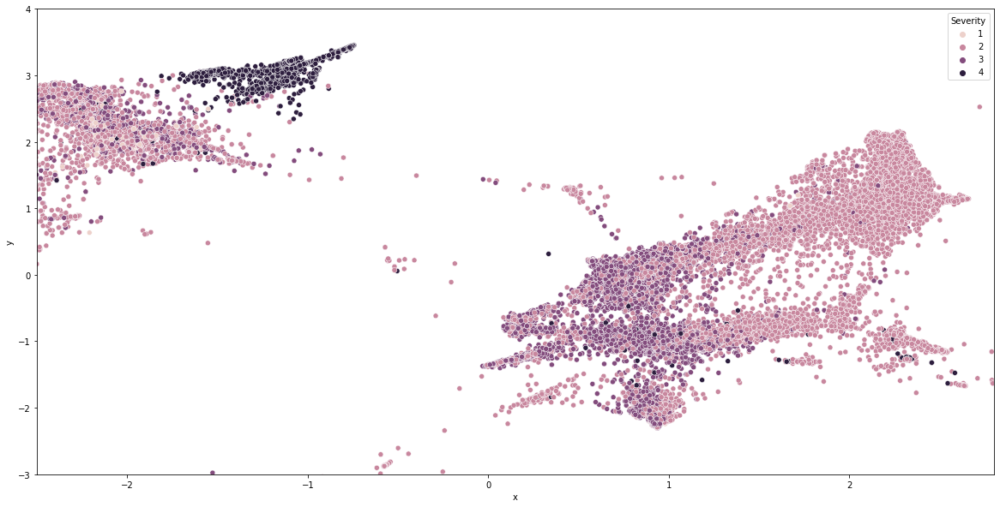

In [ ]:
#visualization accidents: two dimensions graph and cluster by sevirity
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline
g_set = set(df['Severity'])
d = dict(zip(g_set, range(len(g_set))))
colors = [d[g] for g in df["Severity"]]


plt.figure(figsize=(20,10)) 
sns.scatterplot(x="x", y="y", hue="Severity", data=df)

plt.xlim(-2.5,2.8)
plt.ylim(-3,4)

In [ ]:
#choose the cluster in this range(sevirity 4) and take all the descriptions 
def inRange(x,y):
  if -1.6<x<-0.5 and 2.2<y<3.5:
    return True
  else:
    return False  
import turicreate as tc                                                               
relevant = tc.SFrame(df)
relevant = relevant[relevant.apply(lambda r: inRange(r['x'],r['y']))]
relevant_description = relevant.join(sf_graph,on='ID')
relevant_description = relevant_description['ID','Description','x','y','entities_dict']
relevant_description

ID,Description,x,y,entities_dict
A-487709,Closed at US-70/Exit 170- Road closed due to ...,-1.100315809249878,3.2133684158325195,{}
A-1416883,Closed atI-84-BL/Centennial ...,-1.3144619464874268,2.8364171981811523,{'CARDINAL': ['1']}
A-820138,Closed between CrawfordRd and Duck Creek Rd - ...,-1.1173235177993774,2.9103851318359375,{'PERSON': ['CrawfordRd']} ...
A-2798742,Closed at Mt ParanRd/Exit 256 - Road cl ...,-1.117725133895874,3.1873128414154053,{'FAC': ['Mt ParanRd/Exit 256 - Road']} ...
A-1525912,Closed at Ashland - Roadclosed due to accident. ...,-0.754245936870575,3.4386022090911865,{'FAC': ['Ashland -Road']} ...
A-2880476,Closed at MS-740/Exit 263- Road closed due to ...,-1.104231834411621,3.2117085456848145,{}
A-1474385,Closed at Maynardville -Road closed due to ...,-0.7683034539222717,3.418243169784546,{'ORG': ['Maynardville -Road']} ...
A-2575138,Closed betweenUS-30-BR/OR-201/Exit 374 ...,-1.5442581176757812,3.0585739612579346,{}
A-2095874,Closed betweenCR-507/Maple Ave and ...,-1.2426059246063232,2.887502670288086,{}
A-953603,Closed at Saddle Creek -Road closed due to ...,-0.7676571011543274,3.4253764152526855,{'FAC': ['Saddle Creek -Road']} ...


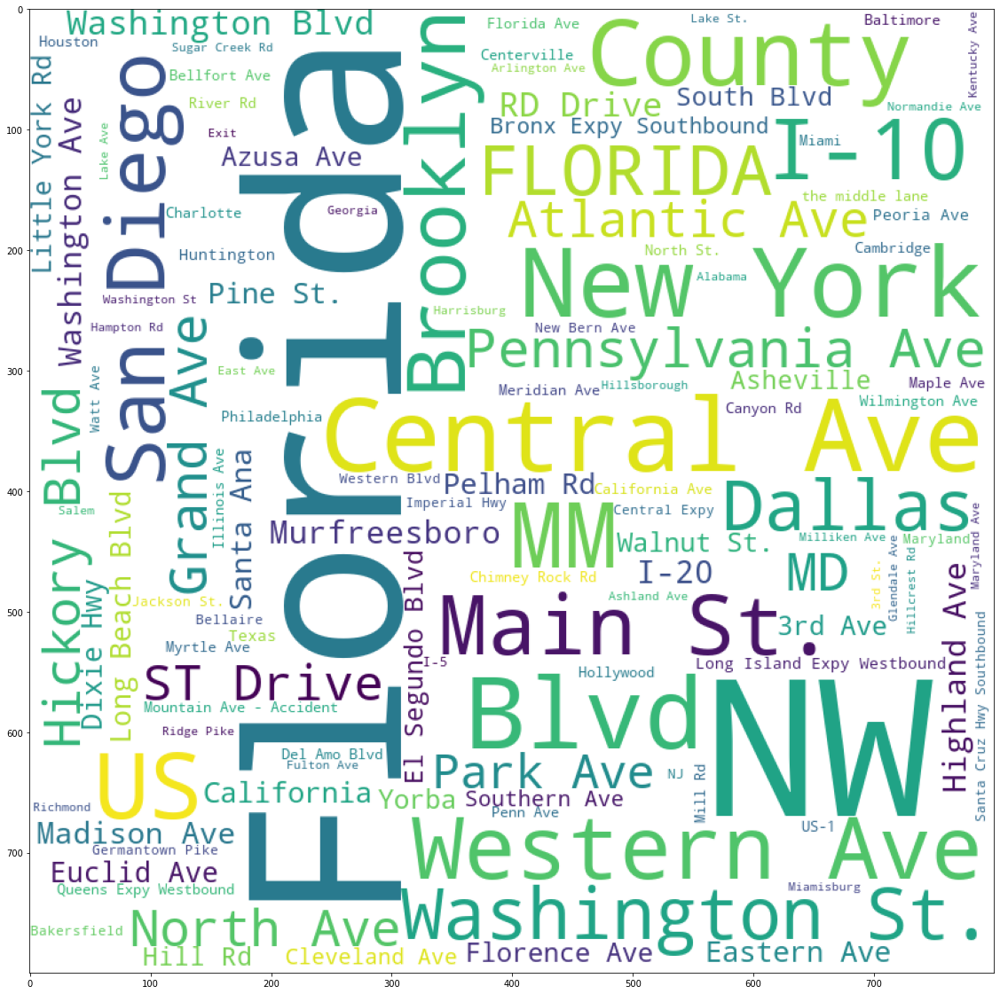

In [ ]:
from nltk.tokenize import word_tokenize
#find all the significant events and locations of accidents with sevirity:4
find_most_common_description = []

for d in sf_graph['entities_dict']:
  if 'GPE' in d:
      find_most_common_description +=  d['GPE'] 
  if 'LOC' in d:
      find_most_common_description +=  d['LOC'] 
  if 'EVENT' in d:
      find_most_common_description +=  d['EVENT']      
draw_word_cloud(find_most_common_description, min_times=1)

now lets look at all states in all the years

In [ ]:
percent = 100/len(sf)
g = display_graph_by_2_coulmns(sf,'State', 'year')
g['state population'] = g.apply(lambda x : all_state_dict[x['year']][x['State']])
g = g.to_dataframe()
g['percent of total crashes'] = g['Number of crashes'].apply(lambda a : '{0:.2f}'.format(a*percent)+'%')
g = sort_by_accumaltive(g,'State', 'year')
g = g.sort_values(['sum','year'],ascending=(True,False))
fig = fig_draw_orientation(g,'State', 'year','sum','percent of total crashes')
fig_update_orientaion(fig,'State', 'year','percent of total crashes','state population')
fig.show()

we can see that in 2020 almost 10% of all accidents in happened califonia 

In [ ]:
def pop_est(r):
 population = all_state_dict[r['year']][r['State']]
 num_crashes = r['Number of crashes']
 return num_crashes/(population/1000)

g = display_graph_by_2_coulmns(sf,'State', 'year')
g['crashes per 1000 people'] = g.apply(lambda r : pop_est(r))
g['state population'] = g.apply(lambda x : all_state_dict[x['year']][x['State']])
g = g.to_dataframe()
g = sort_by_accumaltive(g,'State', 'year','crashes per 1000 people')
g = g.sort_values(['sum','year'],ascending=(True,False))
fig = fig_draw_orientation(g,'State', 'year','sum','crashes per 1000 people')
fig_update_orientaion(fig,'State', 'year','crashes per 1000 people','state population')
fig.show()

we can see that if we normalized the data to be by 1000 people califonia dropped to third place, south carolina and oregon became the top states 

---------------

lets look at counties

In [ ]:
percent = 100/len(sf)
g = display_graph_by_2_coulmns(sf,'County', 'year')
g['state population'] = g.apply(lambda x : all_state_dict[x['year']][county_state_dict[x['County']]])
g['county population'] = g.apply(lambda x : all_counties_dict[x['year']][x['County']])
g['percent of total crashes'] = g['Number of crashes'].apply(lambda a : '{0:.2f}'.format(a*percent)+'%')
g = g.to_dataframe()
g = sort_by_accumaltive(g,'County', 'year')
g = g.sort_values(['sum','year'],ascending=(False,True))
g = g[:250]
g = g.sort_values(['sum','year'],ascending=(True,False))
fig = fig_draw_orientation(g,'County', 'year','sum','county population','percent of total crashes')
fig_update_orientaion(fig,'County', 'year','county population','percent of total crashes')
fig.show()



we can see that califonia once again is at the top with the county of Los Angeles. The other top counties are also in populated states.

In [ ]:
def pop_est(r):
 population = all_counties_dict[r['year']][r['County']]
 num_crashes = r['Number of crashes']
 return num_crashes/(population/1000)

g = display_graph_by_2_coulmns(sf,'County', 'year')
g['county population'] = g.apply(lambda x : all_counties_dict[x['year']][x['County']])
g['crashes per 1000 people'] = g.apply(lambda r : pop_est(r))
g = g.to_dataframe()
g = sort_by_accumaltive(g,'County', 'year','crashes per 1000 people')
g = g.sort_values(['sum','year'],ascending=(False,True))
g = g[:248]
g = g.sort_values(['sum','year'],ascending=(True,False))
county_crashes_per_1000_info = g
fig = fig_draw_orientation(g,'County', 'year','sum','crashes per 1000 people','county population')
fig_update_orientaion(fig,'County', 'year','crashes per 1000 people','county population')
fig.show()
county_crashes_per_1000 = list(g['County'].unique())


we can see that the vast majority of accidents per 1000 residents in counties happened in oregon. 

In [ ]:
import folium
counties_show = []
tiles = 'Stamen Terrain'
m = folium.Map(location=[40.896698, -90.994043], zoom_start=4,
               tiles = tiles)



for r in sf:
    if len(counties_show) == 50:
      break
    if r['County'] in county_crashes_per_1000 and r['County'] not in counties_show:
      counties_show.append(r['County'])
      folium.Marker(
          location=[r['End_Lat'],r['End_Lng']],
          popup= f"<b>{r['County']}" ,
          icon=folium.Icon(color='black', icon='fa-car',prefix='fa')
      ).add_to(m)


m

### 1.2 Maps and folium displays

Once again we will show information only for 2020

In [ ]:
#adding for how long the car stayed on the road for
from datetime import datetime, timedelta

def days_between(d1, d2):
    d1 = d1[:16]
    d2 = d2[:16]
    d1 = datetime.strptime(d1, "%Y-%m-%d %H:%M")
    d2 = datetime.strptime(d2, "%Y-%m-%d %H:%M")
    return str(d1-d2)
sf_2020['Time spent on road'] = sf_2020.apply(lambda r: days_between(r['End_Time'], r['Start_Time']))

In [ ]:
sf_2020 = sf_2020.dropna()

In [ ]:
#creating an SFrame for longest drives before a crash
sf_2020['Distance(km)'] = sf_2020['Distance(mi)'].apply(lambda a: '{0:.2f}'.format(a/1.60934))
sf_furthest_distance_crashes = sf_2020.sort('Distance(km)',ascending=False)

In [ ]:
#showing the top 200 longest roads, in red are the roads that are also in the top 50 crashes per 1000 residents 

import folium

tiles = 'Stamen Terrain'
m = folium.Map(location=[40.896698, -90.994043], zoom_start=4,
               tiles = tiles)

for  r in sf_furthest_distance_crashes[:200]:
    lat1 = r['Start_Lat']
    lon1 = r['Start_Lng']
    lat2 = r['End_Lat']
    lon2 = r['End_Lng']
    coordinates = [
      [lat1, lon1],
      [lat2, lon2]]
    lat3 = (lat1 + lat2)/2
    lon3 = (lon1 + lon2)/2
    my_PolyLine=folium.PolyLine(locations=coordinates,weight=r['Severity'],color='black')
    m.add_child(my_PolyLine)
    tooltip = f"{r['Street']}<br>{r['County']} county <br><b><u>time<u><b>: {r['Time spent on road']}<br>severity: {r['Severity']}<br>discription: {r['Description']}" 
    folium.Marker(
        location=[lat3,lon3],
        popup= tooltip,
        icon=folium.Icon(color='black',icon='fa-road', prefix='fa')
    ).add_to(m)


m

In [ ]:
#sort the counties by most populated, and keep only one of each
sf_most_populated_counties = sf_2020.sort('POPESTIMATE2020',ascending=False)
unique_pop = sf_most_populated_counties.unique()
avg = sum(unique_pop['POPESTIMATE2020']) / len(unique_pop['POPESTIMATE2020'])

In [ ]:
import folium
from folium.plugins import HeatMap
from folium import FeatureGroup ,LayerControl

tiles = 'Stamen Terrain'
m = folium.Map(location=[40.896698, -90.994043], zoom_start=4,
               tiles = tiles)

#take only a random 20% of the 2020 sf 
random_sample_sf_heat, x= sf_2020.random_split(0.2)
#create 2 feature groups, one for crashes and one for population
feature_group_pop = FeatureGroup(name="Population")
feature_group_crash = FeatureGroup(name="Crashes")

data1 = []
data2 = []

#crashes
for r in random_sample_sf_heat:
  d = (r['End_Lat'],r['End_Lng'],r['Severity']) 
  data2.append(d)
# here we choose the most populated counties from the uniqie_pop sf
for r in unique_pop[:len(random_sample_sf_heat)]:
  d = (r['End_Lat'],r['End_Lng'],r['POPESTIMATE2020']/avg) 
  data1.append(d)

gradient = {.33: 'red', .66: 'brown', 1: 'green'}
HeatMap(data1, radius = 20,gradient=gradient,show=False).add_to(feature_group_pop)
HeatMap(data2, radius = 20,show=False).add_to(feature_group_crash)

feature_group_pop.add_to(m)
feature_group_crash.add_to(m)
LayerControl().add_to(m)

m

In [ ]:
from folium.plugins import MarkerCluster
from folium import FeatureGroup ,LayerControl

#function to display crash crash information 
def pop_text_crash(r):
    txt = f"<b>{r['Start_Time']}</b><br> {r['Description']}</b><br>severity level of: {r['Severity']}"
    return txt
#function to display population information 
def pop_text_pop(r):
    txt = f"<b>population: {r['POPESTIMATE2020']}</b><br> {r['County']}</b><br>"
    return txt

#function to display crash severity by color
def get_color(date):
    if date == 4:
      return 'red'
    elif date == 3:
        return 'darkorange'
    elif date == 2:
      return 'cadetblue'
    return 'springgreen'
#create 2 feature groups
feature_group_pop_cluster = FeatureGroup(name="Population cluster")
feature_group_crash_cluster = FeatureGroup(name="Crashes cluster")

m = folium.Map(zoom_start=4, tiles='OpenStreetMap',location=[40.896698, -90.994043])
mc = MarkerCluster()
mc_2 = MarkerCluster()

#choose a random 1% of the 2020 crashes
random_sample_sf, x= sf_2020.random_split(0.01)
for r in random_sample_sf:
    mc.add_child(folium.CircleMarker(location=[r['End_Lat'],r['End_Lng']],
                        radius=5,color=get_color(r['Severity']), popup=pop_text_crash(r), parse_html=True)).add_to(feature_group_crash_cluster)

#choose the top N most poplulated counties ( N = 1% of the 2020 crashes )
for r in unique_pop[:len(random_sample_sf)]:
    mc_2.add_child(folium.CircleMarker(location=[r['End_Lat'],r['End_Lng']],
                        radius=5,color=get_color(r['Severity']), popup=pop_text_pop(r), parse_html=True)).add_to(feature_group_pop_cluster)


feature_group_pop_cluster.add_to(m)
feature_group_crash_cluster.add_to(m)
LayerControl().add_to(m)

m
